In [1]:
import pandas as pd
import numpy as np

from google.colab import files

uploaded = files.upload()

Saving market_no_outliers.csv to market_no_outliers.csv


In [2]:
import matplotlib.pylab as plt 
import seaborn as sns
import plotly.graph_objs as go
from plotly.offline import iplot
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from scipy import stats

market = pd.read_csv('market_no_outliers.csv')
market.shape

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


(426221, 175)

In [4]:
#To fixate the results between attempts we'll set the random state to 42
random_state = 42

pca = PCA(n_components = None, random_state = random_state)
X = pca.fit_transform(market)
pca.explained_variance_ratio_

array([9.99999977e-01, 1.77585368e-08, 4.20862030e-09, 4.93237407e-10,
       1.55823257e-10, 4.42173544e-11, 3.51611548e-11, 2.04649117e-11,
       1.86207292e-11, 1.74295425e-11, 1.54210023e-11, 1.47485844e-11,
       1.38262004e-11, 1.32208990e-11, 1.03233589e-11, 9.51284872e-12,
       8.76237663e-12, 8.06677526e-12, 5.98037832e-12, 5.69109941e-12,
       4.85160488e-12, 4.50357197e-12, 4.27443125e-12, 3.88587682e-12,
       3.59181721e-12, 3.04609965e-12, 2.96950358e-12, 2.89503335e-12,
       2.84206821e-12, 2.70238436e-12, 2.64340653e-12, 2.61521597e-12,
       2.46389216e-12, 2.39330582e-12, 2.28307934e-12, 2.03283619e-12,
       1.87597775e-12, 1.76763342e-12, 1.72697090e-12, 1.62065500e-12,
       1.59657981e-12, 1.48416034e-12, 1.41013461e-12, 1.35403368e-12,
       1.30773696e-12, 1.26792463e-12, 1.22308451e-12, 1.14844869e-12,
       1.12035694e-12, 1.07104935e-12, 1.02677626e-12, 1.00662091e-12,
       9.26190440e-13, 8.39892563e-13, 7.80344725e-13, 7.68061220e-13,
      

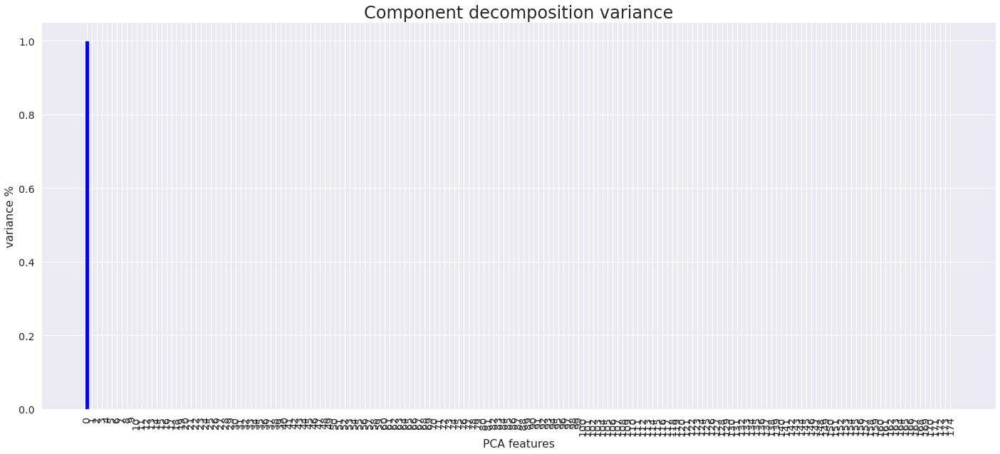

In [5]:
sns.set(font_scale = 1.3)
features = range(pca.n_components_)
plt.figure(figsize=(24,10))
plt.bar(features, pca.explained_variance_ratio_, color='blue')
plt.title("Component decomposition variance", fontsize=24)
plt.xlabel('PCA features')
plt.ylabel('variance %')
plt.xticks(rotation=90)
plt.xticks(features)
plt.show()

In [9]:
#Just so we can fix a point between attempts we'll work with every compononet that is higher that 5%
#components_limit = 0.05
#components = pca.explained_variance_ratio_[pca.explained_variance_ratio_ > components_limit]
number_components = 3

pca = PCA(n_components = number_components, random_state = random_state) 
X = pca.fit_transform(market)
pca.explained_variance_ratio_, sum(pca.explained_variance_ratio_)

(array([9.99999977e-01, 1.77585368e-08, 4.20862030e-09]), 0.9999999990184425)

In [10]:
# Visual libraries
wss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters = i, init = 'k-means++', random_state = random_state)
    kmeans.fit(X)
    wss.append(kmeans.inertia_)

fig = go.Figure()
fig.add_trace(go.Scatter(x=list(range(1, 11)), y=wss, name='elbow', mode='lines'))

fig.update_layout(title='The Elbow Method', 
                  xaxis={"title": "Number of clusters"},
                  yaxis={"title": "Within Sum of Squares"})

fig.show()

In [11]:
number_clusters = 3
kmeans = KMeans(n_clusters = number_clusters, init = 'k-means++', random_state = random_state)
y_kmeans = kmeans.fit_predict(X)

# Visualising the clusters

fig = go.Figure()

fig.add_trace(go.Scatter3d(x=X[y_kmeans == 0, 0], y=X[y_kmeans == 0, 1], z=X[y_kmeans == 0, 2], name='Cluster 1', mode='markers'))
fig.add_trace(go.Scatter3d(x=X[y_kmeans == 1, 0], y=X[y_kmeans == 1, 1], z=X[y_kmeans == 0, 2], name='Cluster 2', mode='markers'))
fig.add_trace(go.Scatter3d(x=X[y_kmeans == 2, 0], y=X[y_kmeans == 2, 1], z=X[y_kmeans == 0, 2], name='Cluster 3', mode='markers'))
#fig.add_trace(go.Scatter3d(x=X[y_kmeans == 3, 0], y=X[y_kmeans == 3, 1], z=X[y_kmeans == 0, 2], name='Cluster 4', mode='markers'))
#fig.add_trace(go.Scatter(x=X[y_kmeans == 4, 0], y=X[y_kmeans == 4, 1], name='Cluster 5', mode='markers'))
#fig.add_trace(go.Scatter(x=X[y_kmeans == 5, 0], y=X[y_kmeans == 5, 1], name='Cluster 6', mode='markers'))
#fig.add_trace(go.Scatter(x=X[y_kmeans == 6, 0], y=X[y_kmeans == 6, 1], name='Cluster 7', mode='markers'))#comment the lines if you chose less clusters
#add more lines if you chose more clusters

fig.add_trace(go.Scatter3d(x=kmeans.cluster_centers_[:, 0], y=kmeans.cluster_centers_[:, 1],z=kmeans.cluster_centers_[:, 2], name='Centroids', 
                         mode='markers', marker_color="rgb(255,255,0)", marker=dict(size=16)))

fig.update_layout(title='Clusters')

fig.show()

In [ ]:
from sklearn.metrics import silhouette_score
from sklearn.metrics import calinski_harabasz_score
from sklearn.metrics import davies_bouldin_score

kmeans = KMeans(n_clusters = number_clusters, init = 'k-means++', random_state = random_state).fit(X)
labels = kmeans.labels_

silhouette = silhouette_score(X, labels, metric='sqeuclidean')
calinski = calinski_harabasz_score(X, labels)
davies = davies_bouldin_score(X, labels)

print('The Silhouette Coefficient for {0} clusters with {1} components is: {2}.'
      '\nThe Silhouette Coefficient is bounded between -1 for incorrect clustering and +1 for highly dense clustering.' 
      '\nScores around zero indicate overlapping clusters.'.format(number_clusters, number_components, "%.2f" % silhouette))

In [ ]:
print('The Calinski-Harabasz Index for {0} clusters with {1} components is: {2}.'
      '\nThe Calinski-Harabasz score is higher when clusters are dense and well separated'
      .format(number_clusters, number_components, "%.2f" % calinski))

In [ ]:
print('The Davies-Bouldin Index for {} clusters with {} components is: {}.'
      '\nThe Davies-Bouldin Zero score is the lowest possible score. Values closer to zero indicate a better partition.'
      .format(number_clusters, number_components, "%.2f" % davies))

In [ ]:
for i in range (2,7):
    kmeans = KMeans(n_clusters = i, init = 'k-means++', random_state = random_state).fit(X)
    labels = kmeans.labels_
    calinski = calinski_harabasz_score(X, labels)
    davies = davies_bouldin_score(X, labels)
    silhouette = silhouette_score(X, labels, metric='sqeuclidean')
    print('The Silhouette Coefficient for {0} clusters with {1} components is: {2}.'
          .format(i, number_components, "%.2f" % silhouette))
    print('The Calinski-Harabasz Index for {0} clusters with {1} components is: {2}.'
          .format(i, number_components, "%.2f" % calinski))
    print('The Davies-Bouldin Index for {0} clusters with {1} components is: {2}.\n'
          .format(i, number_components, "%.2f" % davies))

In [ ]:
number_clusters = 2
kmeans = KMeans(n_clusters = number_clusters, init = 'k-means++', random_state = random_state)
y_kmeans = kmeans.fit_predict(X)

# Visualising the clusters

fig = go.Figure()

fig.add_trace(go.Scatter3d(x=X[y_kmeans == 0, 0], y=X[y_kmeans == 0, 1], z=X[y_kmeans == 0, 2], name='Cluster 1', mode='markers'))
fig.add_trace(go.Scatter3d(x=X[y_kmeans == 1, 0], y=X[y_kmeans == 1, 1], z=X[y_kmeans == 0, 2], name='Cluster 2', mode='markers'))
#fig.add_trace(go.Scatter3d(x=X[y_kmeans == 2, 0], y=X[y_kmeans == 2, 1], z=X[y_kmeans == 0, 2], name='Cluster 3', mode='markers'))
#fig.add_trace(go.Scatter3d(x=X[y_kmeans == 3, 0], y=X[y_kmeans == 3, 1], z=X[y_kmeans == 0, 2], name='Cluster 4', mode='markers'))
#fig.add_trace(go.Scatter(x=X[y_kmeans == 4, 0], y=X[y_kmeans == 4, 1], name='Cluster 5', mode='markers'))
#fig.add_trace(go.Scatter(x=X[y_kmeans == 5, 0], y=X[y_kmeans == 5, 1], name='Cluster 6', mode='markers'))
#fig.add_trace(go.Scatter(x=X[y_kmeans == 6, 0], y=X[y_kmeans == 6, 1], name='Cluster 7', mode='markers'))#comment the lines if you chose less clusters
#add more lines if you chose more clusters

fig.add_trace(go.Scatter3d(x=kmeans.cluster_centers_[:, 0], y=kmeans.cluster_centers_[:, 1],z=kmeans.cluster_centers_[:, 2], name='Centroids', 
                         mode='markers', marker_color="rgb(255,255,0)", marker=dict(size=16)))

fig.update_layout(title='Clusters')

fig.show()

In [ ]:
kmeans.cluster_centers_